# Traffic4cast 2021 Data Exploration

![t4c20logo](../t4c20logo.png)

**About:**
In this notebook, we explore the dynamic and static data: format, stats, visualization.

**Caveat:**
In order to make the module imports work properly set `PYTHONPATH=$PWD` before launching the notebook server from the repo root folder.

In [1]:
import datetime
import glob
import itertools
import re
from multiprocessing import Pool
from pathlib import Path

import matplotlib.pyplot as plt
import numpy as np
import tqdm
from IPython.core.display import display
from IPython.core.display import HTML

from baselines.naive_weighted_average_from_stats import generate_stats_files
from data.data_exploration_util import plot_stats_file
from data.data_exploration_util import process_log_sums_per_city_and_year
from data.data_exploration_util import process_sum_per_bin_per_city_year_and_month
from data.data_layout import channel_labels
from data.data_layout import offset_map
from data.data_layout import volume_channel_indices
from data.graph_utils import poor_man_graph_visualization
from data.graph_utils import reconstruct_graph
from metrics.visualization import animate
from util.check_data_raw_dir import check_raw_data_dir
from util.data_range import generate_date_range
from util.h5_util import load_h5_file

In [2]:
%load_ext autoreload
%load_ext snakeviz
%load_ext time
%autoreload 2
%autosave 60

display(HTML("<style>.container { width:80% !important; }</style>"))

The time module is not an IPython extension.


Autosaving every 60 seconds


In [3]:
BASE_FOLDER = "./raw"
check_raw_data_dir(BASE_FOLDER, show_missing=True)

File structure ./raw:  (✓)


## The data set 2021
You can download the data from  HERE Technologies (check for the the download link in the T4c forum
https://www.iarai.ac.at/traffic4cast/forums/forum/competition/competition-2021/).
We're assuming that you extracted the downloaded tarballs into as subfolder called data/raw/.
Check data/README.md for more information on the folder structure.

### Index cities (4 core challenge, 2 extended challenge, 4 training)

In [4]:
cities = [re.search(r".*/([A-Z]+)", s).group(1) for s in glob.glob(f"{BASE_FOLDER}/*/")]
print(f'Found data for {len(cities)} cities: {", ".join(cities)}')

Found data for 10 cities: CHICAGO, ISTANBUL, VIENNA, BERLIN, NEWYORK, MELBOURNE, MOSCOW, BARCELONA, BANGKOK, ANTWERP


In [5]:
core_challenge_temporal_transfer_cities = [re.search(r".*/([A-Z]+)/", s).group(1) for s in glob.glob(f"{BASE_FOLDER}/**/*test_temporal.h5", recursive=True)]
print(
    f"Core challenge (2019 training, 2020 test), {len(core_challenge_temporal_transfer_cities)} "
    f'cities: {", ".join(core_challenge_temporal_transfer_cities)}'
)

Core challenge (2019 training, 2020 test), 4 cities: CHICAGO, ISTANBUL, BERLIN, MELBOURNE


In [6]:
extended_challenge_spatiotemporal_transfer_cities = [
    re.search(r".*/([A-Z]+)/", s).group(1) for s in glob.glob(f"{BASE_FOLDER}/**/*test_spatiotemporal.h5", recursive=True)
]
print(
    f"Extended challenge (test only, 2019 and 2020), {len(extended_challenge_spatiotemporal_transfer_cities)} "
    f'cities: {", ".join(extended_challenge_spatiotemporal_transfer_cities)}'
)

Extended challenge (test only, 2019 and 2020), 2 cities: VIENNA, NEWYORK


In [7]:
full_training_cities = [c for c in cities if c not in core_challenge_temporal_transfer_cities and c not in extended_challenge_spatiotemporal_transfer_cities]
print(f"Training cities (2019 and 2020), {len(full_training_cities)} " f'cities: {", ".join(full_training_cities)}')

Training cities (2019 and 2020), 4 cities: MOSCOW, BARCELONA, BANGKOK, ANTWERP


### A first visualization of training data and maps

Let's visualize the dynamic data (following http://proceedings.mlr.press/v123/martin20a/martin20a.pdf):
Here the logarithm of the per-city sum of all channels overall training images is shown as a proxy for the activity level per pixel.
Only few pixels arealways zero over the whole dataset, nevertheless the street network is still clearly visible in each city.

In [8]:
num_files_per_city_and_year = 2
tasks = [(city, BASE_FOLDER, num_files_per_city_and_year) for city in cities]
with Pool(processes=6) as pool:
    output = list(tqdm.tqdm(pool.imap(process_log_sums_per_city_and_year, tasks), total=len(tasks)))

  0%|          | 0/10 [00:00<?, ?it/s]

no files for VIENNA 2019
no files for VIENNA 2020
no files for NEWYORK 2019
no files for NEWYORK 2020


/home/che/workspaces/neurips2021-traffic4cast/data/data_exploration_util.py:43: RuntimeWarning: divide by zero encountered in log
  log_of_sum_per_city_and_year[(city, year)] = np.log(log_of_sum_per_city_and_year[(city, year)])


no files for CHICAGO 2020


 10%|█         | 1/10 [00:21<03:09, 21.00s/it]/home/che/workspaces/neurips2021-traffic4cast/data/data_exploration_util.py:43: RuntimeWarning: divide by zero encountered in log
  log_of_sum_per_city_and_year[(city, year)] = np.log(log_of_sum_per_city_and_year[(city, year)])


no files for MELBOURNE 2020


/home/che/workspaces/neurips2021-traffic4cast/data/data_exploration_util.py:43: RuntimeWarning: divide by zero encountered in log
  log_of_sum_per_city_and_year[(city, year)] = np.log(log_of_sum_per_city_and_year[(city, year)])
/home/che/workspaces/neurips2021-traffic4cast/data/data_exploration_util.py:43: RuntimeWarning: divide by zero encountered in log
  log_of_sum_per_city_and_year[(city, year)] = np.log(log_of_sum_per_city_and_year[(city, year)])


no files for ISTANBUL 2020


 20%|██        | 2/10 [00:22<01:18,  9.77s/it]/home/che/workspaces/neurips2021-traffic4cast/data/data_exploration_util.py:43: RuntimeWarning: divide by zero encountered in log
  log_of_sum_per_city_and_year[(city, year)] = np.log(log_of_sum_per_city_and_year[(city, year)])


no files for BERLIN 2020


 40%|████      | 4/10 [00:23<00:23,  3.84s/it]/home/che/workspaces/neurips2021-traffic4cast/data/data_exploration_util.py:43: RuntimeWarning: divide by zero encountered in log
  log_of_sum_per_city_and_year[(city, year)] = np.log(log_of_sum_per_city_and_year[(city, year)])
100%|██████████| 10/10 [01:17<00:00,  7.74s/it]


In [9]:
log_of_sum_per_city, log_of_sum_per_city_and_year = zip(*output)
log_of_sum_per_city = dict(itertools.chain.from_iterable(log_of_sum_per_city))
log_of_sum_per_city_and_year = dict(itertools.chain.from_iterable(log_of_sum_per_city_and_year))

In [10]:
print(log_of_sum_per_city.keys())
print(log_of_sum_per_city_and_year.keys())

dict_keys(['CHICAGO', 'ISTANBUL', 'VIENNA', 'BERLIN', 'NEWYORK', 'MELBOURNE', 'MOSCOW', 'BARCELONA', 'BANGKOK', 'ANTWERP'])
dict_keys([('CHICAGO', 2019), ('ISTANBUL', 2019), ('BERLIN', 2019), ('MELBOURNE', 2019), ('MOSCOW', 2019), ('MOSCOW', 2020), ('BARCELONA', 2019), ('BARCELONA', 2020), ('BANGKOK', 2019), ('BANGKOK', 2020), ('ANTWERP', 2019), ('ANTWERP', 2020)])


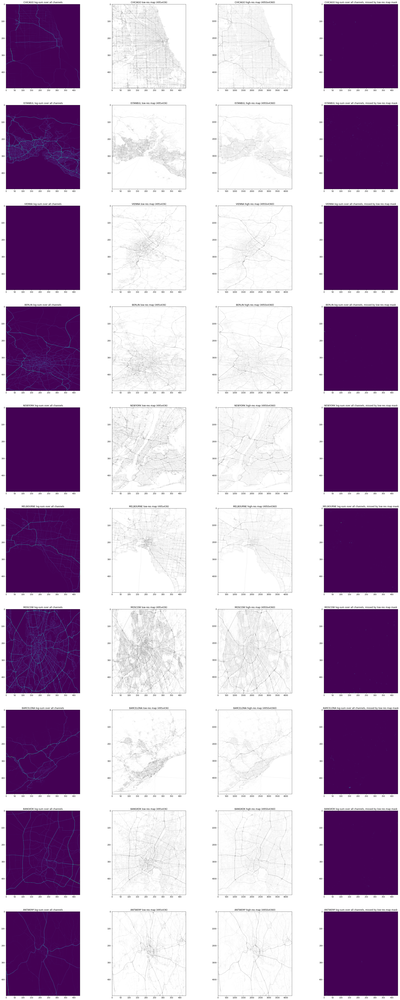

In [11]:
rows = len(cities)
cols = 4
scale_factor = 10
fig, axs = plt.subplots(rows, cols, figsize=(cols * scale_factor, rows * scale_factor))
r_lb = 0
c_lb = 0
r_num = 495
c_num = 436

for i, city in enumerate(cities):
    static_mask_once = np.where(load_h5_file(f"{BASE_FOLDER}/{city}/{city}_static.h5")[0] > 0, 0, 1)

    axs[i, 1].set_title(f"{city} low-res map (495x436)")
    base_map = load_h5_file(f"{BASE_FOLDER}/{city}/{city}_static.h5")[0]
    r_ub = r_lb + r_num
    c_ub = c_lb + c_num
    axs[i, 1].imshow(base_map[r_lb:r_ub, c_lb:c_ub], cmap="gray_r", vmin=0, vmax=255)
    axs[i, 2].set_title(f"{city} high-res map (4950x4360)")
    r_lb_high_res = r_lb * 10
    r_ub_high_res = (r_ub) * 10
    c_ub_high_res = c_ub * 10
    c_lb_high_res = c_lb * 10
    axs[i, 2].imshow(
        load_h5_file(f"{BASE_FOLDER}/{city}/{city}_map_high_res.h5")[r_lb_high_res:r_ub_high_res, c_lb_high_res:c_ub_high_res], cmap="gray_r", vmin=0, vmax=255,
    )

    if city not in log_of_sum_per_city:
        continue
    axs[i, 0].set_title(f"{city} log-sum over all channels")
    axs[i, 0].imshow(log_of_sum_per_city[city][r_lb:r_ub, c_lb:c_ub])

    axs[i, 3].set_title(f"{city} log-sum over all channels, missed by low-res map mask")
    axs[i, 3].imshow((static_mask_once * log_of_sum_per_city[city])[r_lb:r_ub, c_lb:c_ub])

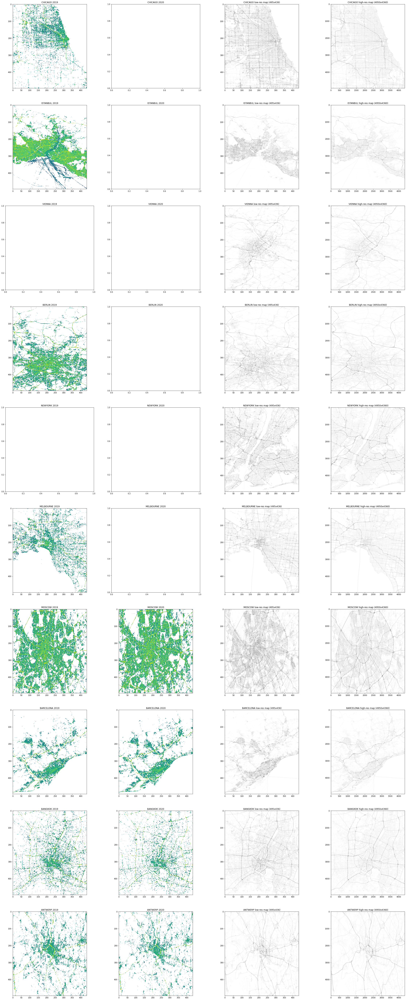

In [12]:
cols = 4
rows = len(cities)

scale_factor = 10
fig, axs = plt.subplots(rows, cols, figsize=(cols * scale_factor, rows * scale_factor))
for i, city in enumerate(cities):
    for j, year in enumerate([2019, 2020]):
        data = log_of_sum_per_city_and_year.get((city, year), None)
        ax = axs[i, j]
        ax.set_title(f"{city} {year}")
        if data is None:
            continue
        ax.imshow(data)
    axs[i, 2].set_title(f"{city} low-res map (495x436)")
    axs[i, 2].imshow(load_h5_file(f"{BASE_FOLDER}/{city}/{city}_static.h5")[0], cmap="gray_r", vmin=0, vmax=255)
    axs[i, 3].set_title(f"{city} high-res map (4950x4360)")
    axs[i, 3].imshow(load_h5_file(f"{BASE_FOLDER}/{city}/{city}_map_high_res.h5"), cmap="gray_r", vmin=0, vmax=255)

## Exploring dynamic data

The data comes in $288$ $5$-minute bins covering one day ($24h=288\cdot5min$). The frame has $495\times436$ pixels and $8$ `uint8` channels.

In [13]:
print(list(enumerate(channel_labels)))

[(0, 'volume_NE'), (1, 'speed_NE'), (2, 'volume_NW'), (3, 'speed_NW'), (4, 'volume_SE'), (5, 'speed_SE'), (6, 'volume_SW'), (7, 'speed_SW'), (8, 'incidents')]


Let's load one day of training data and inspect the the data format.

In [14]:
training_files = sorted(glob.glob(f"{BASE_FOLDER}/**/training/*8ch.h5", recursive=True))
print(f"Found {len(training_files)} training files")

Found 2164 training files


In [15]:
index = 1200  # arbitrary index
print(f"Loading file {training_files[index]}")
data = load_h5_file(training_files[index])
print(f"Loaded data has shape {data.shape} with dtype {data.dtype} between {np.min(data)} and {np.max(data)}")

Loading file ./raw/BERLIN/training/2019-04-29_BERLIN_8ch.h5
Loaded data has shape (288, 495, 436, 8) with dtype uint8 between 0 and 255


Let's animate one day. Use `ffmpeg -i <video>.mp4 <animated gif>.gif` to create an animated gif.

100%|██████████| 288/288 [00:00<00:00, 312.50it/s]


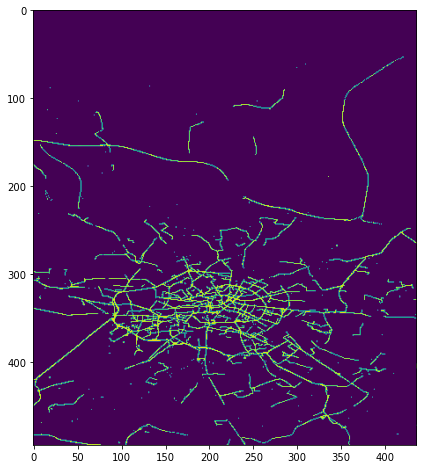

In [16]:
try:
    anim_data = np.log(data.sum(axis=(-1)) + 0.000001)
    animate(anim_data, interval=200, file=training_files[0].replace(".h5", ".mp4"))
except Exception as e:
    print(e)

Let's inspect the distribution of the data over the day for one pixel. We see that data may be sparse and models need to be able to cope with it.

Reading pixel 489,359


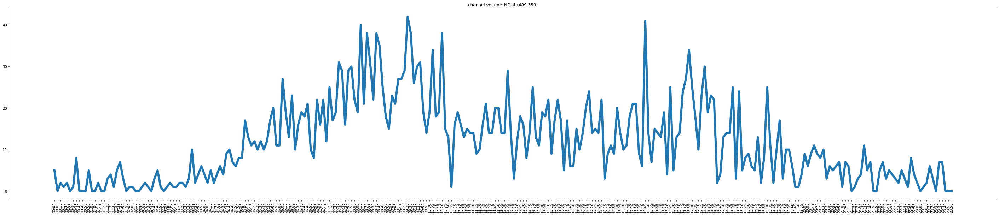

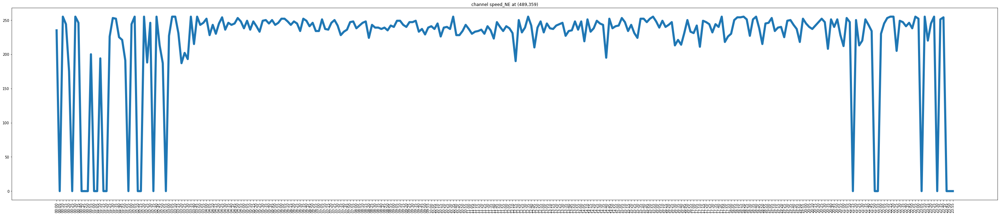

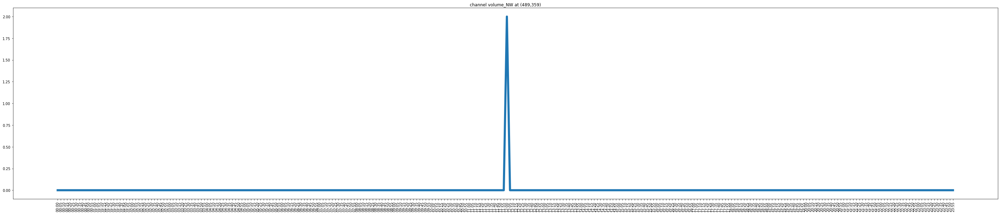

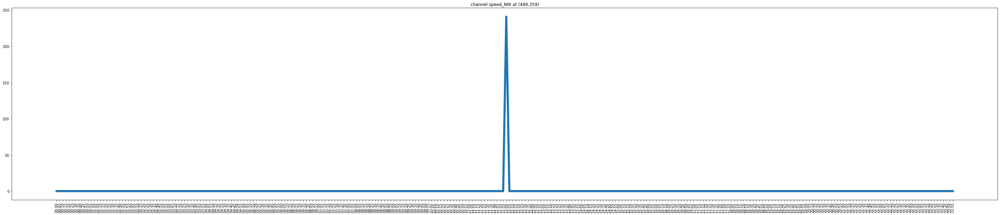

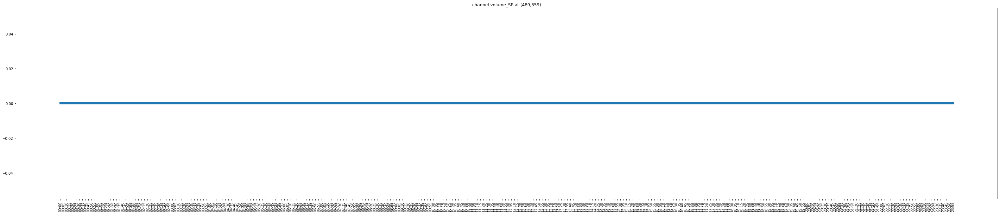

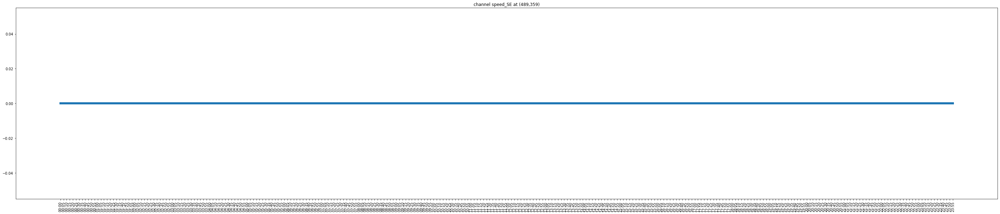

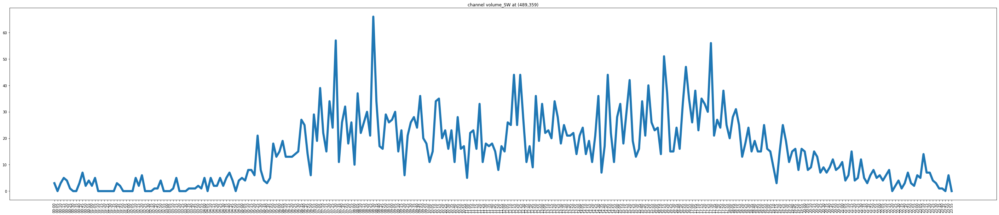

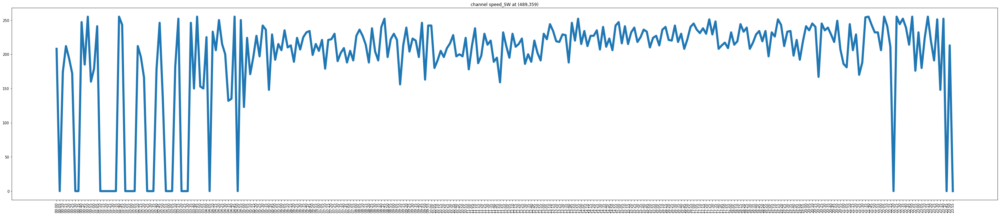

In [17]:
# find an interesting pixel: take cell with max sum in NE channel
dailysum = np.sum(data, axis=(0))
channel = 1
unravelled = np.unravel_index([np.argmax(dailysum[:, :, channel])], (495, 436))
x = unravelled[0][0]
y = unravelled[1][0]
print(f"Reading pixel {x},{y}")

for ch in range(data.shape[3]):
    plt.figure(figsize=(50, 10))
    plt.title(f"channel {channel_labels[ch]} at ({x},{y})")
    x_labels = [datetime.time(hour=t // 12, minute=t % 12 * 5).isoformat(timespec="minutes") for t in range(288)]
    plt.plot(x_labels, data[:, x, y, ch], linewidth=6)
    plt.xticks(rotation=90)
    plt.show()

Let's now pick additional two pixels and plot both the volume and speed.

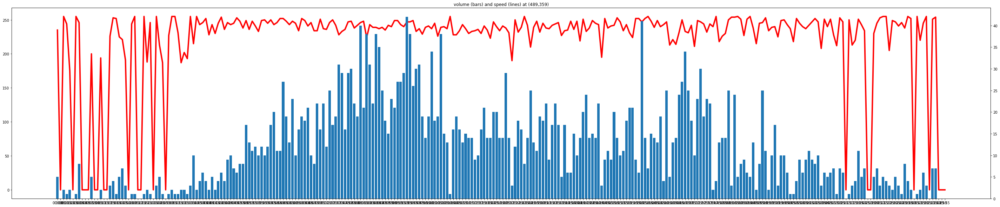

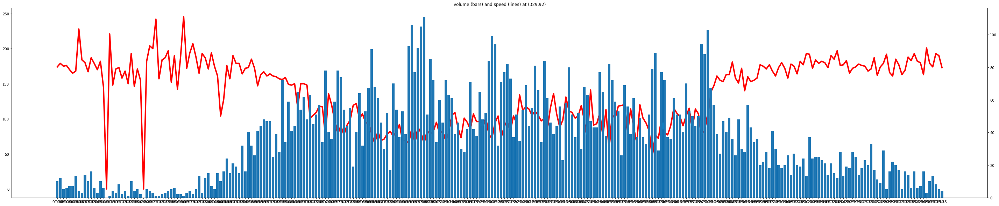

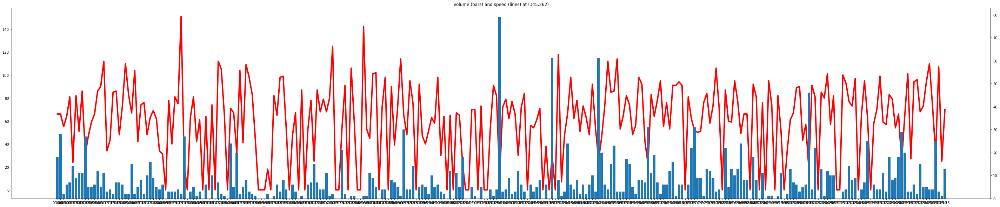

In [18]:
def plot_volume_and_speed(x, y):
    fig, ax1 = plt.subplots(figsize=(50, 10))
    ax1.set_title(f"volume (bars) and speed (lines) at ({x},{y})")
    x_labels = [datetime.time(hour=t // 12, minute=t % 12 * 5).isoformat(timespec="minutes") for t in range(288)]
    # ax1.set_xticks(rotation=90)
    ax1.plot(x_labels, data[:, x, y, 1], linewidth=4, color="red")
    ax2 = ax1.twinx()
    ax2.bar(x_labels, data[:, x, y, 0])
    plt.show()


plot_volume_and_speed(489, 359)
plot_volume_and_speed(329, 92)
plot_volume_and_speed(345, 262)

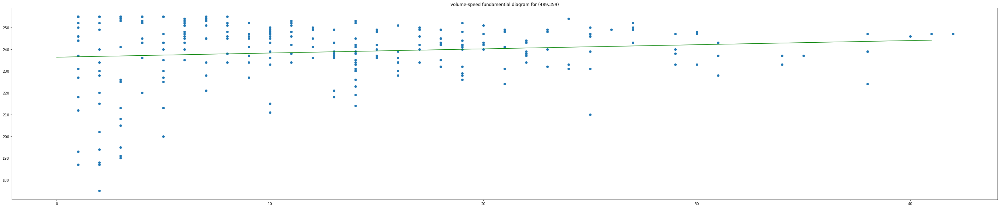

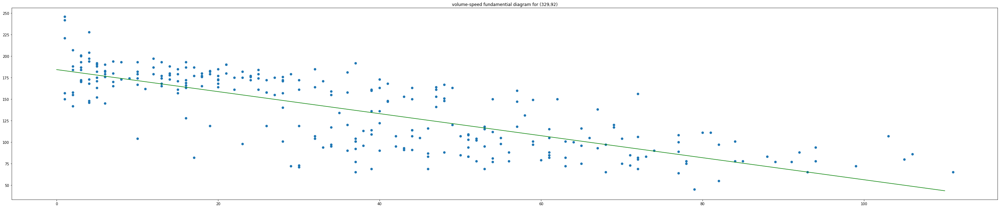

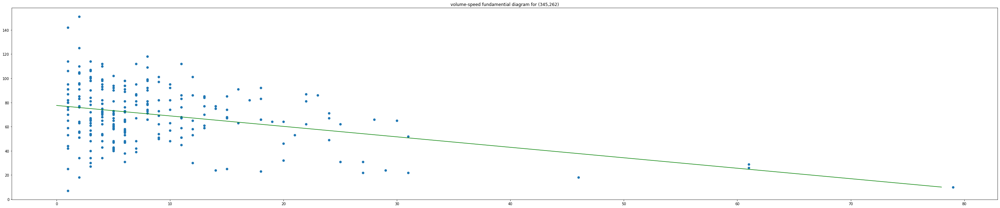

In [19]:
def plot_fundamental_diagram(row, col):
    x = data[:, row, col, 0]
    y = data[:, row, col, 1]
    filtering = x > 0
    x = x[filtering]
    y = y[filtering]

    linear_model = np.polyfit(x, y, 1)
    linear_model_fn = np.poly1d(linear_model)
    x_s = np.arange(0, max(x))

    plt.figure(figsize=(50, 10))

    plt.title(f"volume-speed fundamential diagram for ({row},{col})")
    plt.plot(x_s, linear_model_fn(x_s), color="green")
    plt.scatter(x, y)


plot_fundamental_diagram(489, 359)
plot_fundamental_diagram(329, 92)
plot_fundamental_diagram(345, 262)

### Temporal shift in training cities

In [20]:
pre_covid_range = generate_date_range("2019-04-01", "2019-04-10")
in_covid_range = generate_date_range("2020-04-01", "2020-04-10")
list(enumerate(channel_labels))
print(volume_channel_indices)

[0, 2, 4, 6]


In [21]:
pre_covid_volumina = {city: np.zeros(shape=(495, 436)) for city in full_training_cities}
in_covid_volumina = {city: np.zeros(shape=(495, 436)) for city in full_training_cities}
for city in tqdm.tqdm(full_training_cities, position=0, desc="cities"):
    for date in tqdm.tqdm(pre_covid_range, position=1, desc="pre-covid"):
        pre_covid_volumina[city] += np.sum(load_h5_file(f"{BASE_FOLDER}/{city}/training/{date}_{city}_8ch.h5")[:, :, :, volume_channel_indices], axis=(0, -1))
    for date in tqdm.tqdm(in_covid_range, position=2, desc="in-covid"):
        in_covid_volumina[city] += np.sum(load_h5_file(f"{BASE_FOLDER}/{city}/training/{date}_{city}_8ch.h5")[:, :, :, volume_channel_indices], axis=(0, -1))

pre-covid: 100%|██████████| 10/10 [00:30<00:00,  3.07s/it]


in-covid:   0%|          | 0/10 [00:00<?, ?it/s]

in-covid:  10%|█         | 1/10 [00:02<00:26,  2.96s/it]

in-covid:  20%|██        | 2/10 [00:06<00:24,  3.01s/it]

in-covid:  30%|███       | 3/10 [00:08<00:20,  2.98s/it]

in-covid:  40%|████      | 4/10 [00:11<00:17,  2.98s/it]

in-covid:  50%|█████     | 5/10 [00:14<00:15,  3.01s/it]

in-covid:  60%|██████    | 6/10 [00:18<00:12,  3.06s/it]

in-covid:  70%|███████   | 7/10 [00:21<00:09,  3.20s/it]

in-covid:  80%|████████  | 8/10 [00:24<00:06,  3.10s/it]

in-covid:  90%|█████████ | 9/10 [00:27<00:03,  3.15s/it]

pre-covid: 100%|██████████| 10/10 [00:29<00:00,  2.96s/it]


in-covid:   0%|          | 0/10 [00:00<?, ?it/s]

in-covid:  10%|█         | 1/10 [00:02<00:24,  2.70s/it]

in-covid:  20%|██        | 2/10 [00:05<00:21,  2.67s/it]

in-covid:  30%|███       | 3/10 [00:08<00:18,  2.67s/it]

in-covid:  40%|████      | 4/10 [00:10<00:16,  2.75s/it]

in-covid:  50%|█████    

['2019-04-01', '2019-04-02', '2019-04-03', '2019-04-04', '2019-04-05', '2019-04-06', '2019-04-07', '2019-04-08', '2019-04-09', '2019-04-10']
MOSCOW: 732155698.0
BARCELONA: 23257227.0
BANGKOK: 60936302.0
ANTWERP: 41934886.0
['2020-04-01', '2020-04-02', '2020-04-03', '2020-04-04', '2020-04-05', '2020-04-06', '2020-04-07', '2020-04-08', '2020-04-09', '2020-04-10']
MOSCOW: 511333915.0
BARCELONA: 9847119.0
BANGKOK: 34764752.0
ANTWERP: 23836023.0


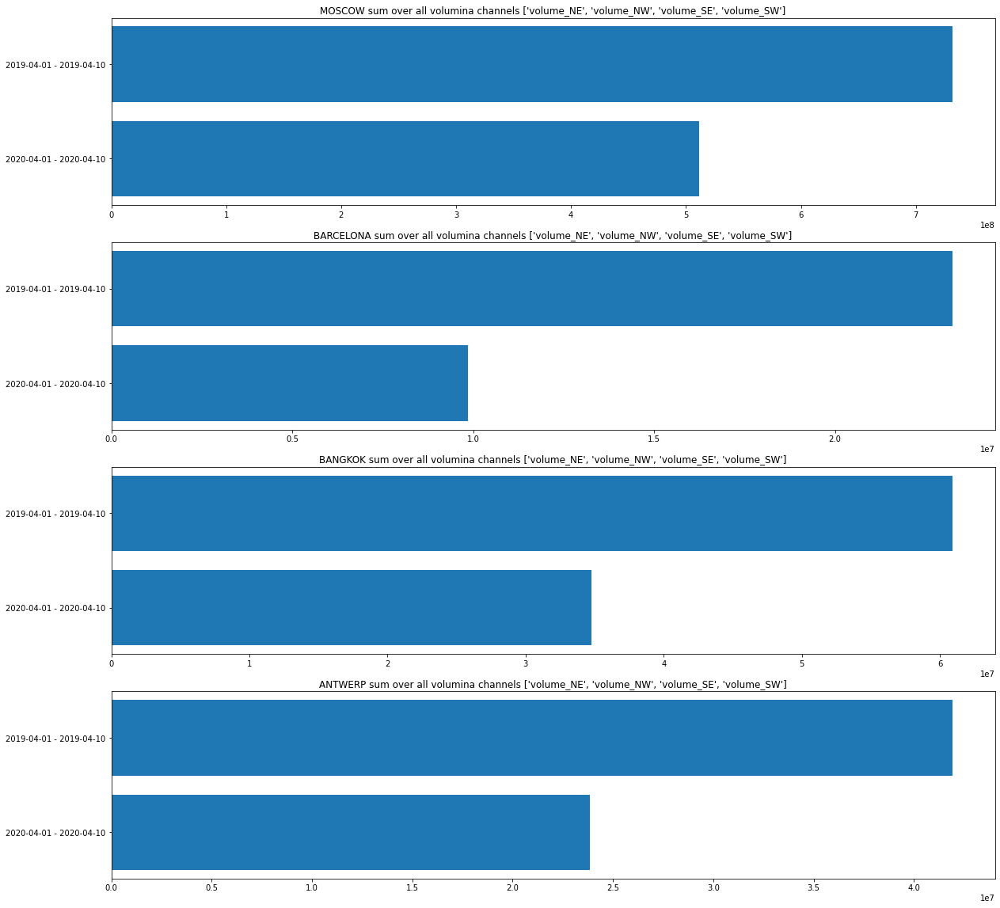

In [22]:
print(pre_covid_range)
for city, volumina in pre_covid_volumina.items():
    print(f"{city}: {np.sum(volumina)}")
print(in_covid_range)
for city, volumina in in_covid_volumina.items():
    print(f"{city}: {np.sum(volumina)}")
scale_factor = 2

fig, axs = plt.subplots(len(full_training_cities), 1, figsize=(scale_factor * 10, len(cities) * scale_factor))

for i, city in enumerate(full_training_cities):
    axs[i].set_title(f"{city} sum over all volumina channels {[channel_labels[ch] for ch in volume_channel_indices]}")
    axs[i].barh(
        [f"{pre_covid_range[0]} - {pre_covid_range[-1]}", f"{in_covid_range[0]} - {in_covid_range[-1]}"],
        [np.sum(pre_covid_volumina[city]), np.sum(in_covid_volumina[city])],
    )
    axs[i].invert_yaxis()

### Daytime distribution in training cities

In [23]:
years = [2019, 2020]
months = ["04", "05"]
num_files_per_city_and_year = 10
tasks = [(city, BASE_FOLDER, num_files_per_city_and_year, years, months) for city in cities]
with Pool(processes=6) as pool:
    sum_per_bin_per_city_year_and_month = dict(
        itertools.chain(*list(tqdm.tqdm(pool.imap(process_sum_per_bin_per_city_year_and_month, tasks), total=len(tasks))))
    )

  0%|          | 0/10 [00:00<?, ?it/s]

./raw/CHICAGO/training/2019-04-01_CHICAGO_8ch.h5
no files for VIENNA 2019no files for NEWYORK 2019./raw/BERLIN/training/2019-04-01_BERLIN_8ch.h5./raw/ISTANBUL/training/2019-04-01_ISTANBUL_8ch.h5./raw/MELBOURNE/training/2019-04-01_MELBOURNE_8ch.h5



no files for VIENNA 2019
no files for VIENNA 2020
no files for NEWYORK 2019

no files for VIENNA 2020no files for NEWYORK 2020

no files for NEWYORK 2020./raw/MOSCOW/training/2019-04-01_MOSCOW_8ch.h5

./raw/BARCELONA/training/2019-04-01_BARCELONA_8ch.h5
./raw/MOSCOW/training/2019-04-02_MOSCOW_8ch.h5
./raw/BARCELONA/training/2019-04-02_BARCELONA_8ch.h5
./raw/BERLIN/training/2019-04-02_BERLIN_8ch.h5
./raw/MELBOURNE/training/2019-04-02_MELBOURNE_8ch.h5
./raw/CHICAGO/training/2019-04-02_CHICAGO_8ch.h5
./raw/ISTANBUL/training/2019-04-02_ISTANBUL_8ch.h5
./raw/MELBOURNE/training/2019-04-03_MELBOURNE_8ch.h5
./raw/CHICAGO/training/2019-04-03_CHICAGO_8ch.h5
./raw/BARCELONA/training/2019-04-03_BARCELONA_8ch.h5
./raw/BERLIN/training/2019-04-03_BERLIN_8

 10%|█         | 1/10 [01:24<12:42, 84.77s/it]


./raw/BARCELONA/training/2020-04-01_BARCELONA_8ch.h5
no files for MELBOURNE 2020
no files for MELBOURNE 2020
./raw/ANTWERP/training/2019-04-01_ANTWERP_8ch.h5
./raw/ISTANBUL/training/2019-05-08_ISTANBUL_8ch.h5
./raw/MOSCOW/training/2019-05-08_MOSCOW_8ch.h5
./raw/BANGKOK/training/2019-04-02_BANGKOK_8ch.h5
no files for BERLIN 2020
no files for BERLIN 2020
./raw/BARCELONA/training/2020-04-02_BARCELONA_8ch.h5
./raw/ANTWERP/training/2019-04-02_ANTWERP_8ch.h5
./raw/ISTANBUL/training/2019-05-09_ISTANBUL_8ch.h5
./raw/MOSCOW/training/2019-05-09_MOSCOW_8ch.h5
./raw/BANGKOK/training/2019-04-03_BANGKOK_8ch.h5
./raw/ANTWERP/training/2019-04-03_ANTWERP_8ch.h5
./raw/BARCELONA/training/2020-04-03_BARCELONA_8ch.h5
./raw/MOSCOW/training/2019-05-10_MOSCOW_8ch.h5
./raw/ISTANBUL/training/2019-05-10_ISTANBUL_8ch.h5
./raw/BANGKOK/training/2019-04-04_BANGKOK_8ch.h5
./raw/ANTWERP/training/2019-04-04_ANTWERP_8ch.h5
./raw/BARCELONA/training/2020-04-04_BARCELONA_8ch.h5
./raw/MOSCOW/training/2020-04-01_MOSCOW_8ch.

 20%|██        | 2/10 [01:39<05:46, 43.33s/it]

./raw/ANTWERP/training/2019-04-05_ANTWERP_8ch.h5
./raw/BARCELONA/training/2020-04-05_BARCELONA_8ch.h5
./raw/BANGKOK/training/2019-04-06_BANGKOK_8ch.h5
./raw/MOSCOW/training/2020-04-02_MOSCOW_8ch.h5
./raw/ANTWERP/training/2019-04-06_ANTWERP_8ch.h5
./raw/BARCELONA/training/2020-04-06_BARCELONA_8ch.h5
./raw/BANGKOK/training/2019-04-07_BANGKOK_8ch.h5
./raw/ANTWERP/training/2019-04-07_ANTWERP_8ch.h5
./raw/MOSCOW/training/2020-04-03_MOSCOW_8ch.h5
./raw/BARCELONA/training/2020-04-07_BARCELONA_8ch.h5
./raw/BANGKOK/training/2019-04-08_BANGKOK_8ch.h5
./raw/ANTWERP/training/2019-04-08_ANTWERP_8ch.h5
./raw/BARCELONA/training/2020-04-08_BARCELONA_8ch.h5
./raw/MOSCOW/training/2020-04-04_MOSCOW_8ch.h5
./raw/BANGKOK/training/2019-04-09_BANGKOK_8ch.h5
./raw/ANTWERP/training/2019-04-09_ANTWERP_8ch.h5
./raw/BARCELONA/training/2020-04-09_BARCELONA_8ch.h5
./raw/MOSCOW/training/2020-04-05_MOSCOW_8ch.h5
./raw/BANGKOK/training/2019-04-10_BANGKOK_8ch.h5
./raw/ANTWERP/training/2019-04-10_ANTWERP_8ch.h5
./raw/BA

 70%|███████   | 7/10 [02:53<01:01, 20.35s/it]

./raw/ANTWERP/training/2020-04-08_ANTWERP_8ch.h5
./raw/BANGKOK/training/2020-04-09_BANGKOK_8ch.h5
./raw/ANTWERP/training/2020-04-09_ANTWERP_8ch.h5
./raw/BANGKOK/training/2020-04-10_BANGKOK_8ch.h5
./raw/ANTWERP/training/2020-04-10_ANTWERP_8ch.h5
./raw/BANGKOK/training/2020-05-01_BANGKOK_8ch.h5
./raw/ANTWERP/training/2020-05-01_ANTWERP_8ch.h5
./raw/BANGKOK/training/2020-05-02_BANGKOK_8ch.h5
./raw/ANTWERP/training/2020-05-02_ANTWERP_8ch.h5
./raw/BANGKOK/training/2020-05-03_BANGKOK_8ch.h5
./raw/ANTWERP/training/2020-05-03_ANTWERP_8ch.h5
./raw/BANGKOK/training/2020-05-04_BANGKOK_8ch.h5
./raw/ANTWERP/training/2020-05-04_ANTWERP_8ch.h5
./raw/BANGKOK/training/2020-05-05_BANGKOK_8ch.h5
./raw/ANTWERP/training/2020-05-05_ANTWERP_8ch.h5
./raw/BANGKOK/training/2020-05-06_BANGKOK_8ch.h5
./raw/ANTWERP/training/2020-05-06_ANTWERP_8ch.h5
./raw/BANGKOK/training/2020-05-07_BANGKOK_8ch.h5
./raw/ANTWERP/training/2020-05-07_ANTWERP_8ch.h5
./raw/BANGKOK/training/2020-05-08_BANGKOK_8ch.h5
./raw/ANTWERP/traini

100%|██████████| 10/10 [03:32<00:00, 21.26s/it]


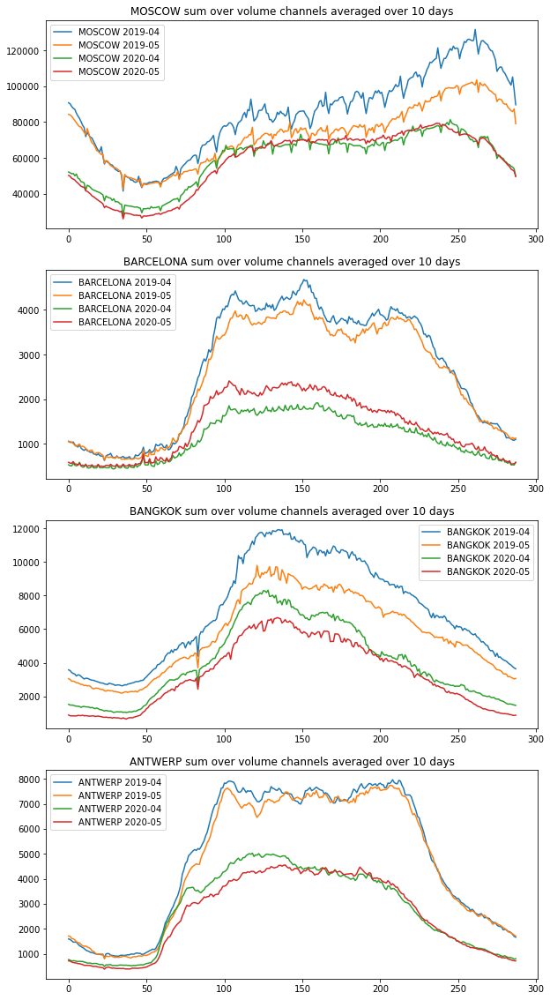

In [24]:
fig, axs = plt.subplots(len(full_training_cities), figsize=(scale_factor * 5, len(cities) * scale_factor))
for i, city in enumerate(full_training_cities):
    ax = axs[i]
    for (year, month) in itertools.product(years, months):
        if (city, year, month) not in sum_per_bin_per_city_year_and_month:
            continue
        ax.plot(sum_per_bin_per_city_year_and_month[(city, year, month)], label=f"{city} {year}-{month}")
        ax.set_title(f"{city} sum over volume channels averaged over {num_files_per_city_and_year} days")
    ax.legend()

## Exploring static data

There is `(9,495,436)` tensor in `<CITY>/<CITY>_static.h5` and a `(4950,4360)` tensor in `<CITY>/<CITY>_map_high_res.h5`.
The first layer of the static data is down-sampled version of the high res map. Gray scales reflect...

Layers 1,...,8 of the static data contain a binary encoding whether the low-res pixel is connected

In [25]:
print(list(offset_map.keys()))

['N', 'NE', 'E', 'SE', 'S', 'SW', 'W', 'NW']


Let's have a look at the number of neighbors of each cell by summing over channel 1,...8

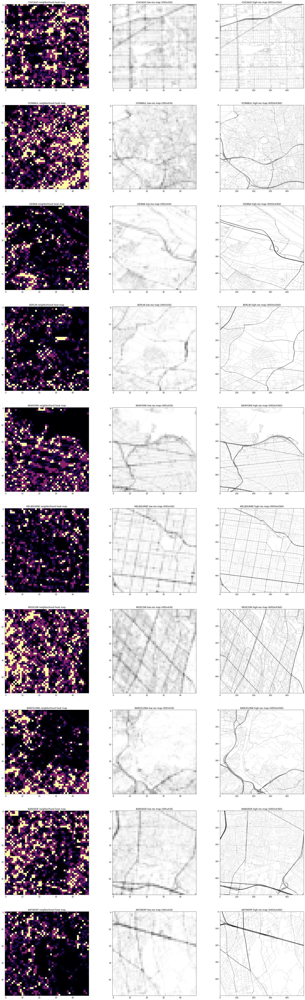

In [26]:
rows = len(cities)
cols = 3
scale_factor = 10
r_start_low = 250
num_r_low = 50
c_start_low = 250
num_c_low = 50
fig, axs = plt.subplots(rows, cols, figsize=(cols * scale_factor, rows * scale_factor))
for i, city in enumerate(cities):
    static_data = load_h5_file(f"{BASE_FOLDER}/{city}/{city}_static.h5")
    high_res_map = load_h5_file(f"{BASE_FOLDER}/{city}/{city}_map_high_res.h5")
    axs[i, 0].set_title(f"{city} neighborhood heat map")
    assert static_data.shape == (9, 495, 436)
    neighborhood_degrees = np.sum(static_data[1:, :, :] / 255, axis=(0))
    assert np.max(neighborhood_degrees) <= 8
    assert np.min(neighborhood_degrees) >= 0
    assert neighborhood_degrees.shape == (495, 436)
    r_end_low = r_start_low + num_r_low
    c_end_low = c_start_low + num_c_low
    axs[i, 0].imshow(np.exp(neighborhood_degrees)[r_start_low:r_end_low, c_start_low:c_end_low], cmap="inferno")
    axs[i, 1].set_title(f"{city} low-res map (495x436)")
    axs[i, 1].imshow(static_data[0][r_start_low:r_end_low, c_start_low:c_end_low], cmap="gray_r", vmin=0, vmax=255)
    axs[i, 2].set_title(f"{city} high-res map (4950x4360)")
    r_start_high = r_start_low * 10
    r_end_high = r_end_low * 10
    c_start_high = c_start_low * 10
    c_end_high = c_end_low * 10
    axs[i, 2].imshow(high_res_map[r_start_high:r_end_high, c_start_high:c_end_high], cmap="gray_r", vmin=0, vmax=255)

Static data was derived from the high-res map; all code can be found in `privat.data_prep/data_prep_02_static_layers[.nb].py`.
Participants may create their own graph/connectivity layer from the high-res map.
Let's have a look at the graph reconstructed from these 8 connectivity layers along with.
Here, each cell is represented by a node (pixels) and neighbors are connected by a straight line.

In [27]:
graphs = {}
for city in tqdm.tqdm(cities):
    static_data = load_h5_file(f"{BASE_FOLDER}/{city}/{city}_static.h5")
    graphs[city] = reconstruct_graph(static_data, city)

100%|██████████| 10/10 [01:06<00:00,  6.65s/it]


In [28]:
poor_man_graph_visualizations = {}
for city in tqdm.tqdm(cities):
    poor_man_graph_visualizations[city] = poor_man_graph_visualization(graphs[city])

100%|██████████| 10/10 [02:59<00:00, 17.97s/it]


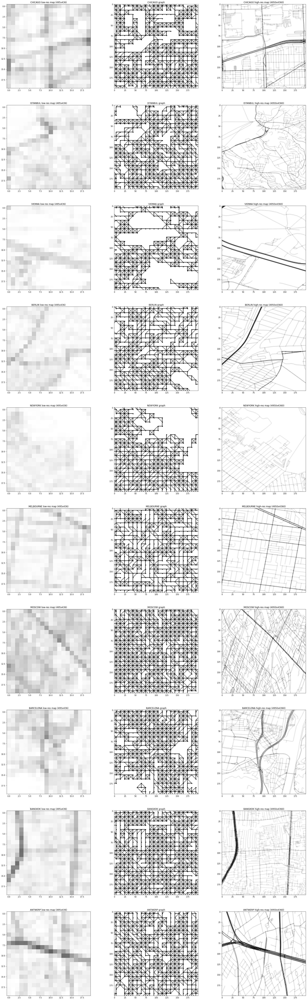

In [29]:
r_start_low = 250
num_r_low = 20
c_start_low = 250
num_c_low = 20
rows = len(cities)
cols = 3
scale_factor = 10
fig, axs = plt.subplots(rows, cols, figsize=(cols * scale_factor, rows * scale_factor))
for i, city in enumerate(cities):
    static_data = load_h5_file(f"{BASE_FOLDER}/{city}/{city}_static.h5")
    high_res_map = load_h5_file(f"{BASE_FOLDER}/{city}/{city}_map_high_res.h5")
    graph_im = poor_man_graph_visualizations[city]

    assert static_data.shape == (9, 495, 436)
    assert graph_im.shape == (4950, 4360)
    assert high_res_map.shape == (4950, 4360)
    axs[i, 1].set_title(f"{city} graph")
    r_start_high = r_start_low * 10
    r_end_low = r_start_low + num_r_low
    r_end_high = r_end_low * 10
    c_start_high = c_start_low * 10
    c_end_low = c_start_low + num_c_low
    c_end_high = c_end_low * 10
    axs[i, 1].imshow(graph_im[r_start_high:r_end_high, c_start_high:c_end_high], cmap="gray_r")
    axs[i, 0].set_title(f"{city} low-res map (495x436)")
    axs[i, 0].imshow(static_data[0][r_start_low:r_end_low, c_start_low:c_end_low], cmap="gray_r", vmin=0, vmax=255)
    axs[i, 2].set_title(f"{city} high-res map (4950x4360)")
    axs[i, 2].imshow(high_res_map[r_start_high:r_end_high, c_start_high:c_end_high], cmap="gray_r", vmin=0, vmax=255)

# Stats

Let's generate hourly mean and std, separated by weekday.

In [30]:
data_raw_dir = Path("./raw")
stats_dir = Path("./stats")
stats_dir.mkdir(parents=True, exist_ok=True)
pool_size = 2
max_num_files = 3

In [31]:
generate_stats_files(
    city="BERLIN",
    dates=generate_date_range(f"2019-04-01", f"2019-05-31"),
    data_raw_dir=data_raw_dir,
    stats_dir=stats_dir,
    max_num_files=max_num_files,
    pool_size=pool_size,
)

100%|██████████| 7/7 [08:17<00:00, 71.09s/it] 


Let's plot them.

### Berlin stats

#1 is a highway in the outskirts.
We see the lower absolute values in the volume channels (left) than speed channels (in the two main directions).
We also see higher std during day time (reflected by the fraction of non-zero volume data points;
there is an almost perfect correlation between std and non-zero fraction in the speed channels.

(3, 168, 495, 436, 8)
float64


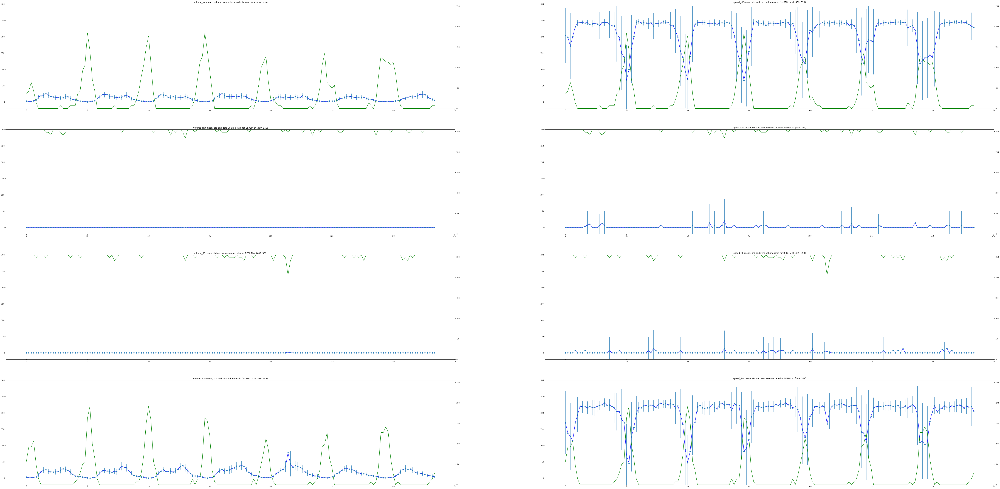

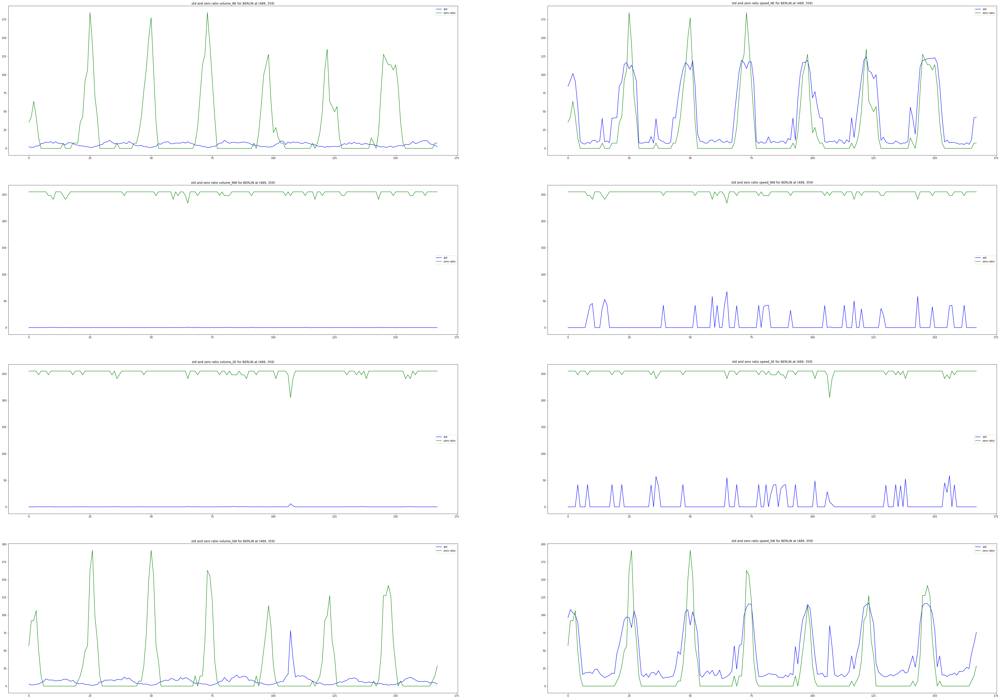

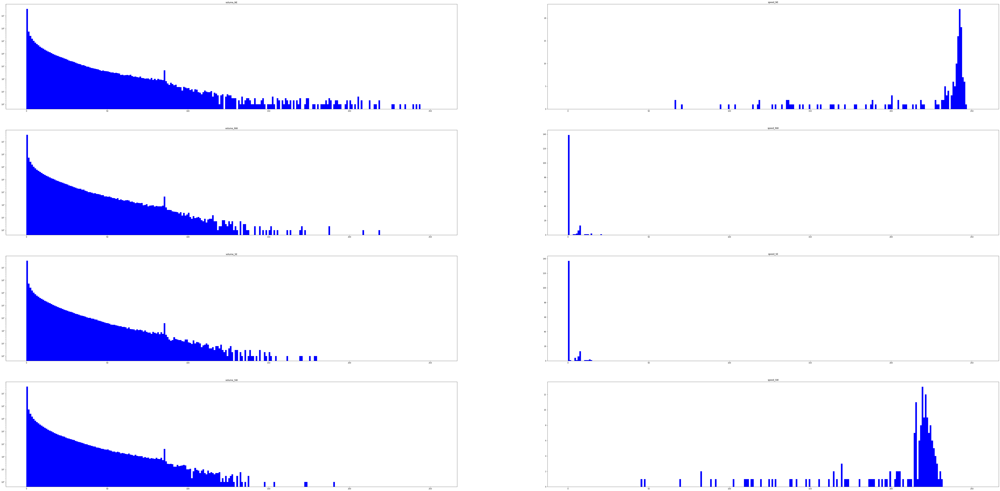

In [32]:
plot_stats_file("BERLIN", 489, 359)

If we take only the mean of speeds when and where there is non-zero volume,
then we see only a slight drop of the mean of the speed channel during the night. Now, the std of speeds is almost constant!

(3, 168, 495, 436, 8)
float64
float64


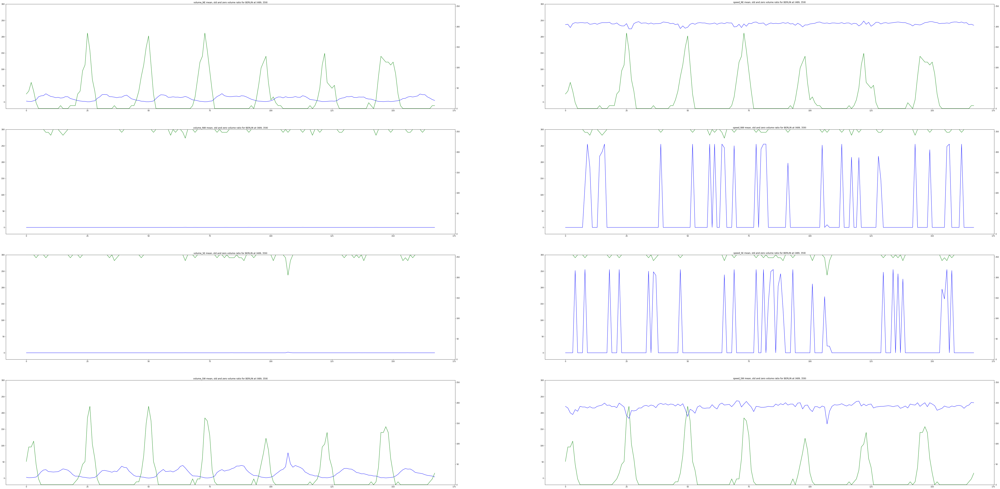

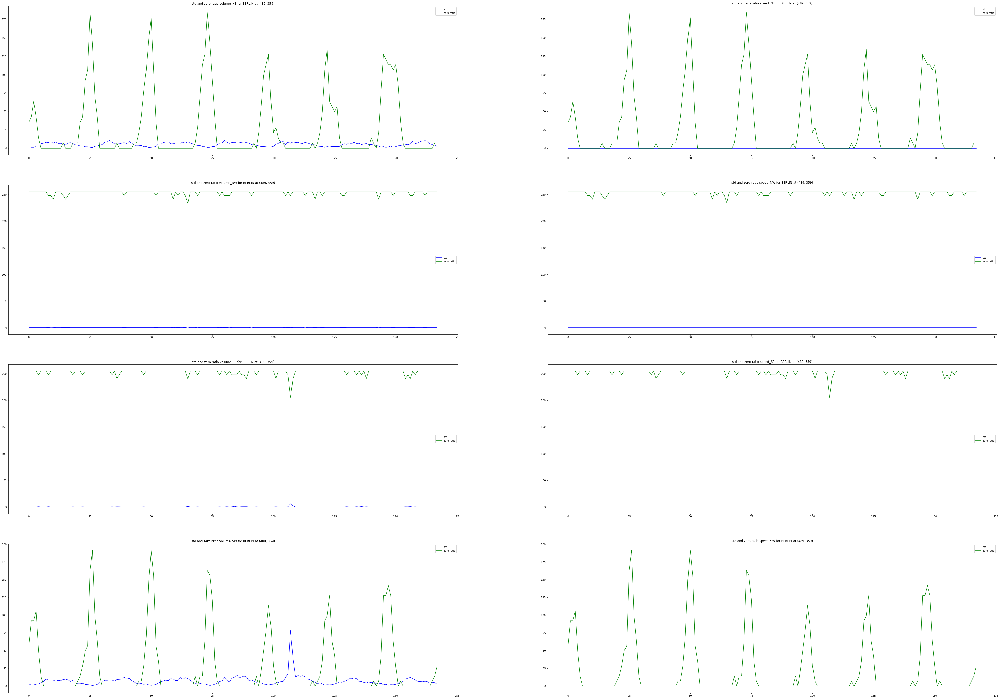

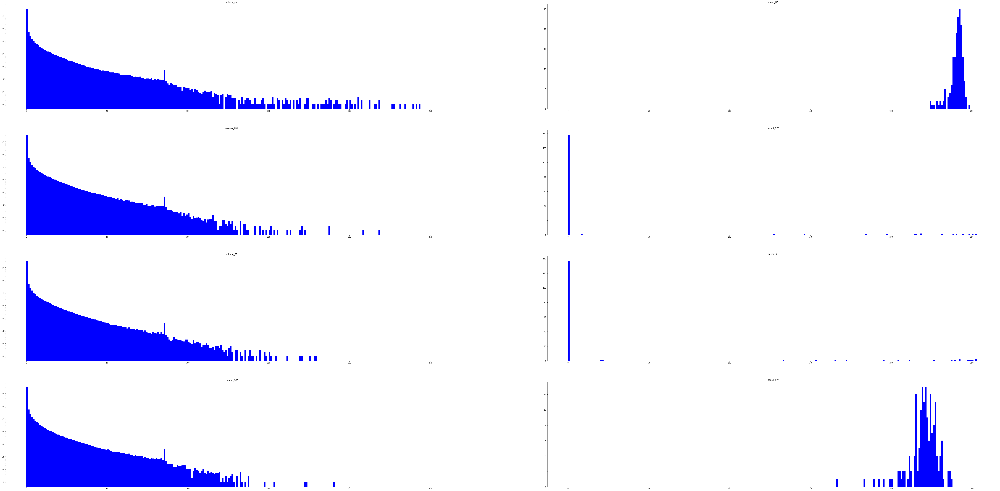

In [33]:
plot_stats_file("BERLIN", 489, 359, normalized=True)

#2 is a highway at the main ring-road. We see greater drops during night time.

(3, 168, 495, 436, 8)
float64


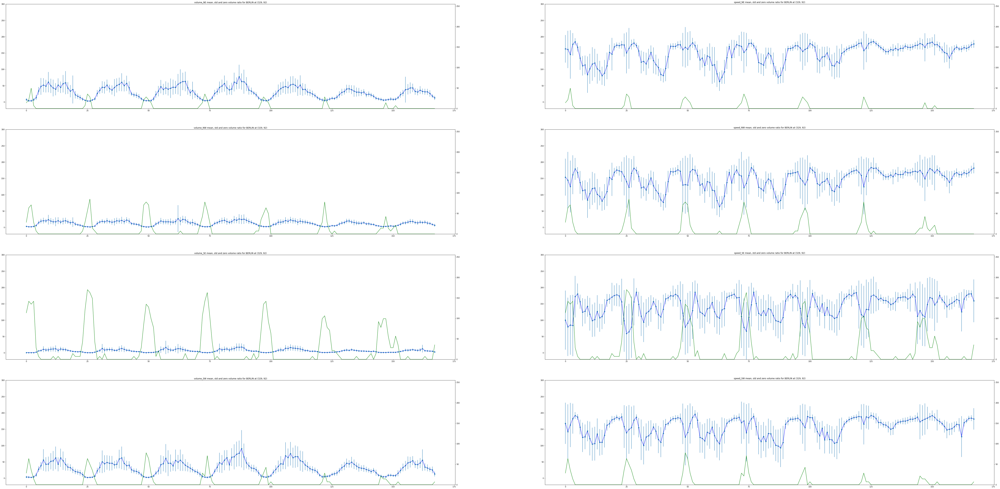

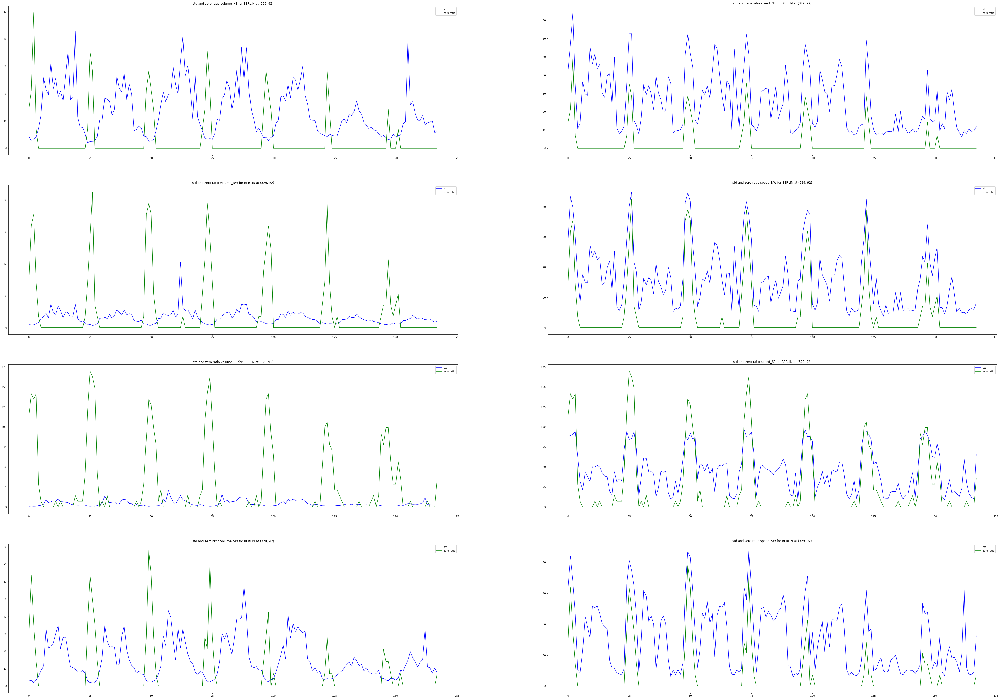

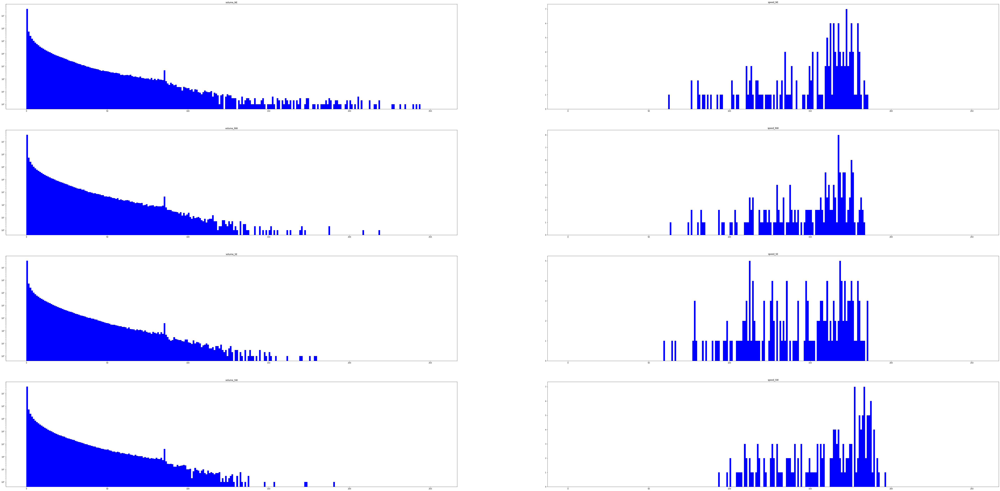

In [34]:
plot_stats_file("BERLIN", 329, 92)

#3 shows a boulevard in the center of Berlin with business as well as housing. We much lower volume and speed levels.

(3, 168, 495, 436, 8)
float64


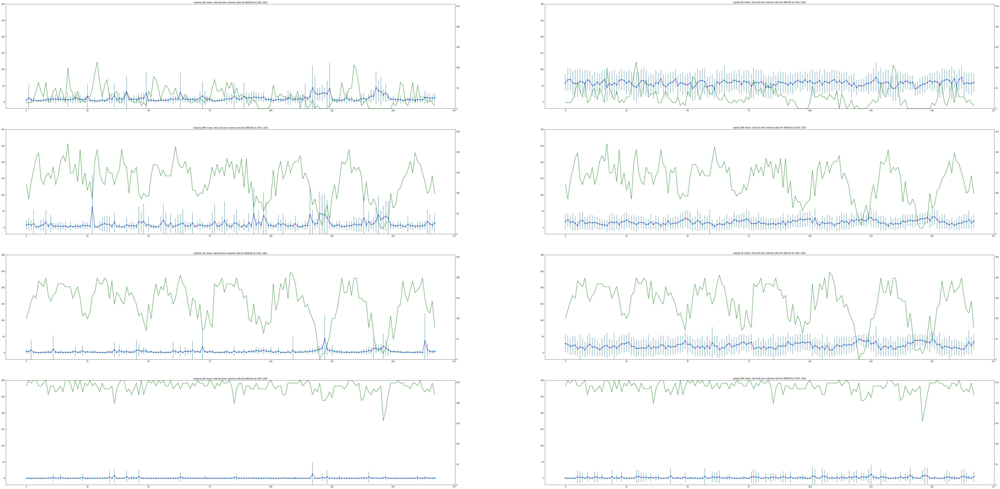

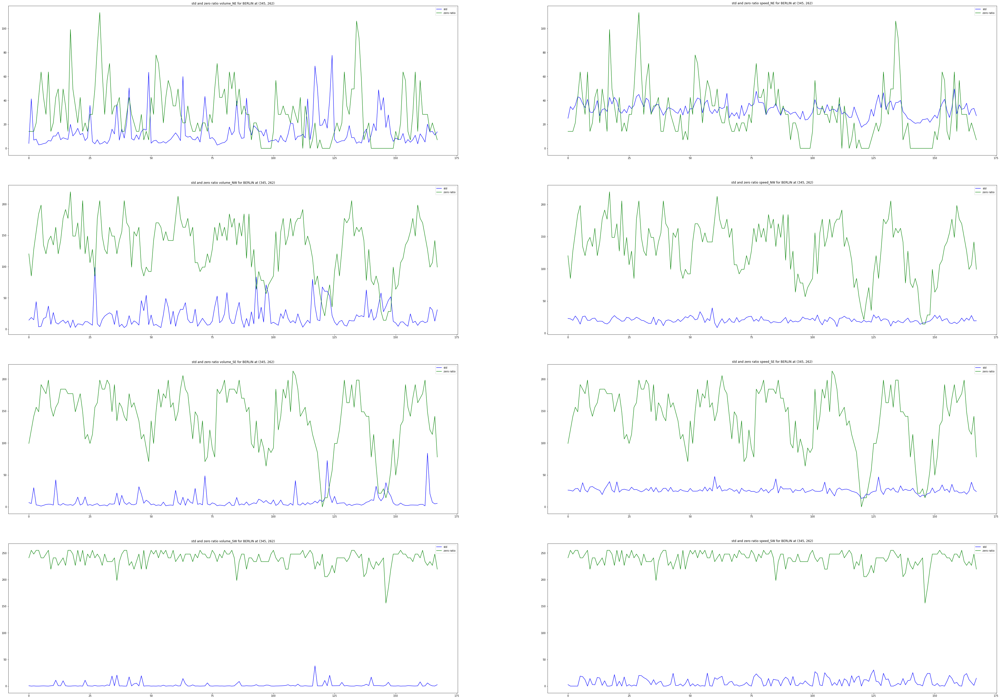

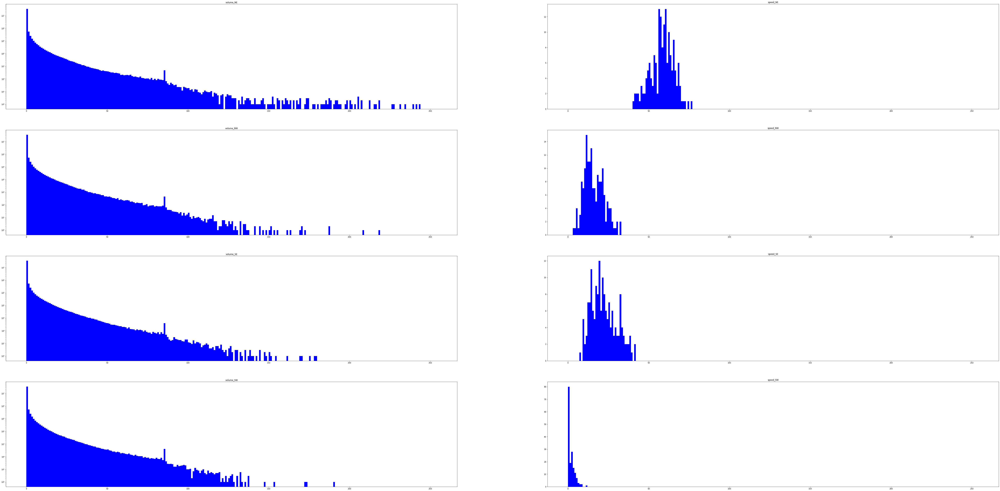

In [35]:
plot_stats_file("BERLIN", 345, 262)

Let's have a look a the full city. We normlize speeds to non-zero volume to see the true speed distribution not distorted by zero speed values. We see the std going up during the off-peak daytimes.

(3, 168, 495, 436, 8)
float64
float64


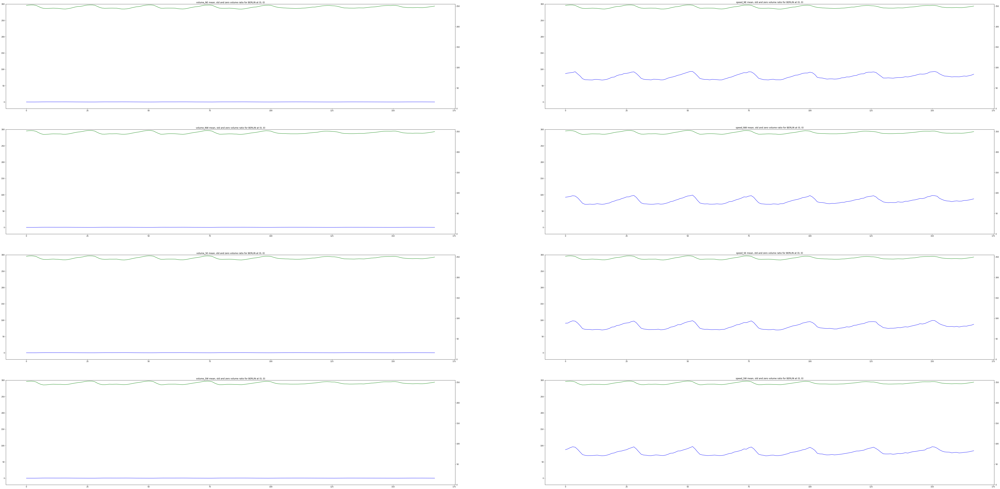

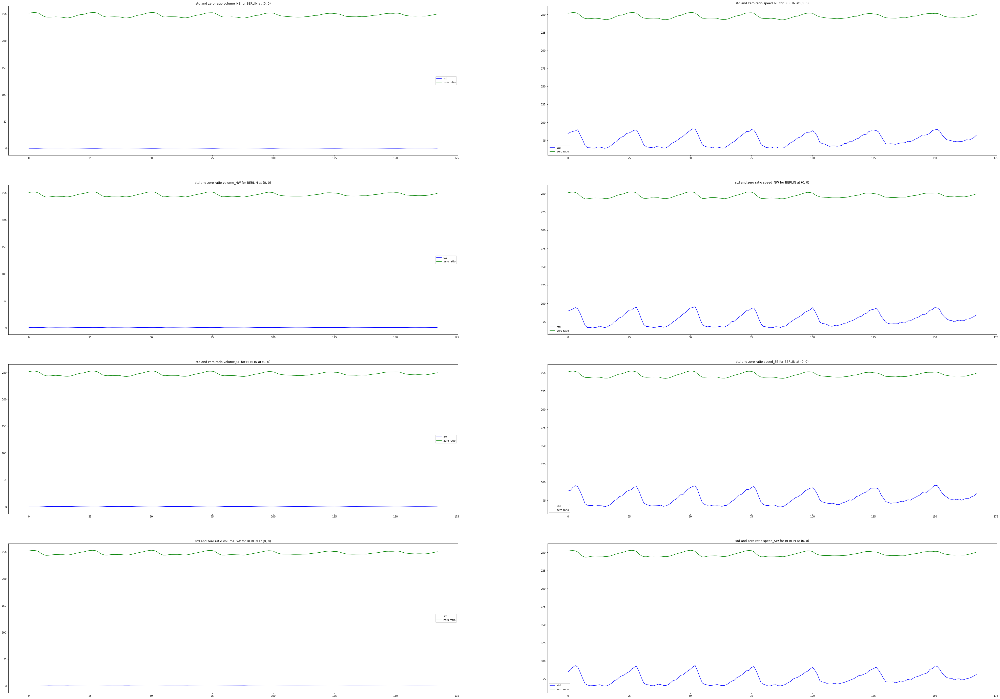

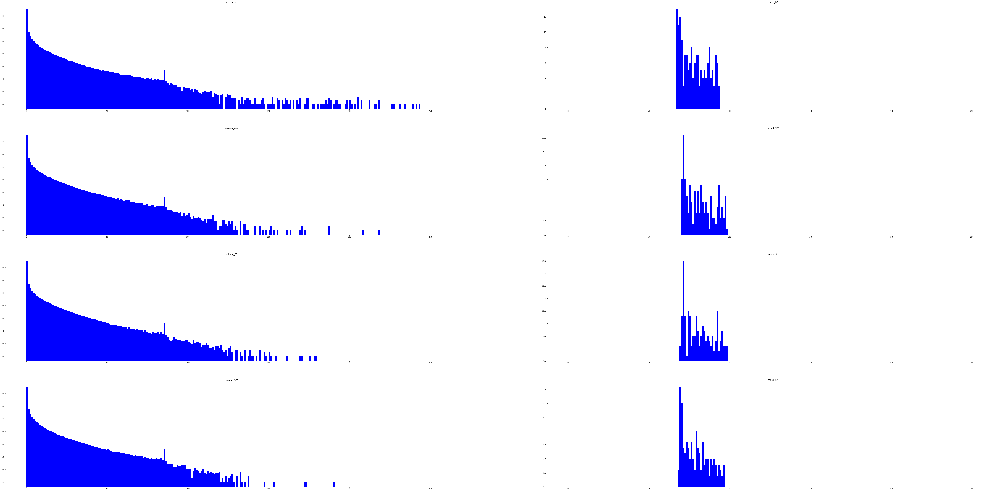

In [41]:
plot_stats_file("BERLIN", normalized=True)

### Chicago stats


Let's have a look at the volume and speed distributions of a different city: Chicago.

In [38]:
generate_stats_files(
    city="CHICAGO",
    dates=generate_date_range(f"2019-04-01", f"2019-05-31"),
    data_raw_dir=data_raw_dir,
    stats_dir=stats_dir,
    max_num_files=max_num_files,
    pool_size=pool_size,
)

100%|██████████| 7/7 [05:00<00:00, 42.88s/it]


(3, 168, 495, 436, 8)
float64
float64


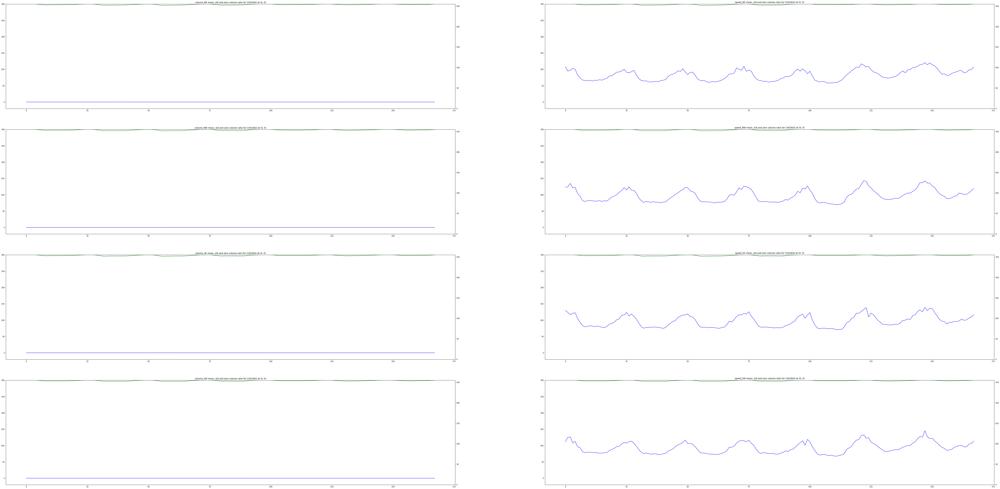

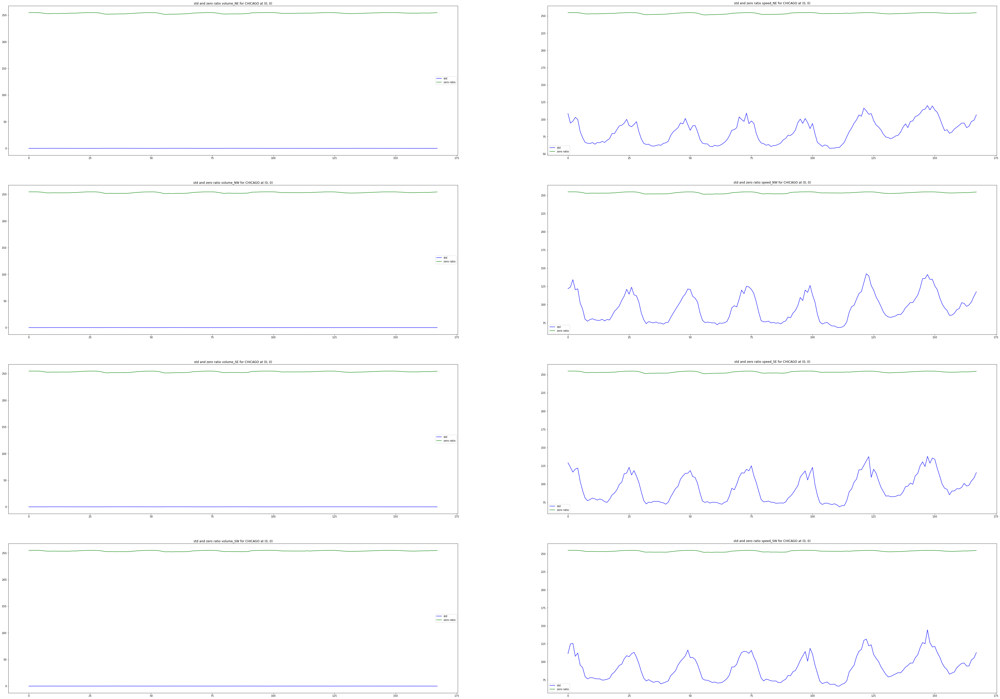

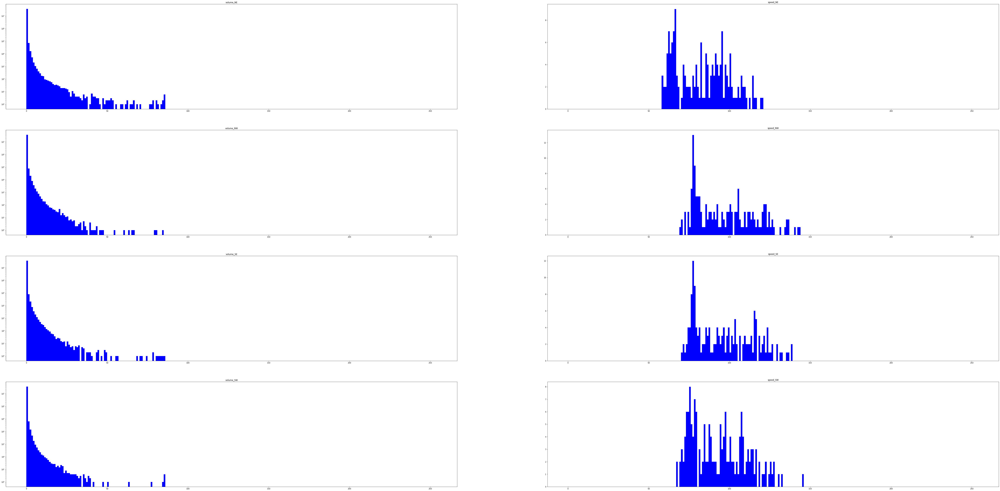

In [39]:
plot_stats_file("CHICAGO", normalized=True)